In [1]:
pip install Keras

Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install scikit-learn

Note: you may need to restart the kernel to use updated packages.


In [3]:
pip install pyodbc

Note: you may need to restart the kernel to use updated packages.


In [4]:
pip install matplotlib

Note: you may need to restart the kernel to use updated packages.


In [5]:
pip install tensorflow

Note: you may need to restart the kernel to use updated packages.


In [6]:
pip install numpy

Note: you may need to restart the kernel to use updated packages.


In [7]:
pip install pandas

Note: you may need to restart the kernel to use updated packages.


In [8]:
pip install sqlalchemy

Note: you may need to restart the kernel to use updated packages.


In [9]:
import pandas as pd

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib. dates as mandates
from sklearn import linear_model
import pandas as pd
import numpy as np
%matplotlib inline
import matplotlib. pyplot as plt
import matplotlib


C:\Users\Evelyn\AppData\Local\Temp\ipykernel_22644\3760706984.py:1: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


In [10]:
from sqlalchemy import create_engine

In [11]:
# #old code 
# # Define the connection details
# server = 'stocksserver.database.windows.net' 
# database = 'stockdb' 
# username = 'Evelyn'
# password = 'Apple2327'

# # Establish the connection
# conn = pyodbc.connect('DRIVER={SQL Server};SERVER='+server+';DATABASE='+database+';UID='+username+';PWD='+ password)

# # Define your SQL query
# query_bs = "select * from Balance_Statement;"
# query_cf = "select * from Cash_Flow;"
# query_is2 = "select * from Income_Statement;"

# # Execute the query and create a DataFrame
# df_bs = pd.read_sql(query_bs, conn)
# df_cf = pd.read_sql(query_cf, conn)
# df_is2 = pd.read_sql(query_is2, conn)



# # SQL price query to make price yearly data 
# query_price = "SELECT Ticker,YEAR(Date) AS Year,AVG(Close_Price) AS Average_Price, MAX(Close_Price) AS Max_Price,MIN(Close_Price) AS Min_Price FROM Daily_Price GROUP BY Ticker, YEAR(Date) ORDER BY Ticker, Year ASC;"
# # Execute the query and create a DataFrame
# df_price = pd.read_sql(query_price, conn)

# # Don't forget to close the connection when done
# conn.close()



In [12]:
import pyodbc
#get the view table from SQL
# Define the connection details
server = 'stocksserver.database.windows.net' 
database = 'stockdb' 
username = 'Evelyn'
password = 'Apple2327'

# Establish the connection
conn = pyodbc.connect('DRIVER={SQL Server};SERVER='+server+';DATABASE='+database+';UID='+username+';PWD='+ password)
query_price = "SELECT  * from join_balance_income_cash_flow_daily_price"
# Execute the query and create a DataFrame
clean_df = pd.read_sql(query_price, conn)

# Don't forget to close the connection when done
conn.close()
clean_df


C:\Users\Evelyn\AppData\Local\Temp\ipykernel_22644\1139617671.py:13: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  clean_df = pd.read_sql(query_price, conn)


,Ticker,Year,Total_Assets,Total_CurrentAssets,Total_Liabilities,Total_ShareholderEquity,Cash_And_CashEquivalents,LongTerm_Investments,Total_CurrentLiabilities,Current_Debt,...,EBITDA,Operating_Cashflow,Capital_Expenditures,Cashflow_Investment,Cashflow_Financing,Dividend_Payout,Net_Income,Average_Price,Max_Price,Min_Price
0,AAL,2023-12-31,6.305800e+10,1.357200e+10,6.826000e+10,-5.202000e+09,5.780000e+08,0.000000e+00,2.206200e+10,3.632000e+09,...,5.202000e+09,3.803000e+09,2.596000e+09,-5.020000e+08,-3.206000e+09,0.000000e+00,8.220000e+08,14.599038,18.35,10.92
1,AAL,2020-12-31,6.200800e+10,1.109500e+10,6.887500e+10,-6.867000e+09,2.450000e+08,0.000000e+00,1.656900e+10,2.797000e+09,...,-8.186000e+09,-6.543000e+09,1.958000e+09,-4.342000e+09,1.099400e+10,4.300000e+07,-8.885000e+09,15.333207,29.20,9.04
2,AAL,2022-12-31,6.471600e+10,1.526900e+10,7.051500e+10,-5.799000e+09,4.400000e+08,0.000000e+00,2.149600e+10,3.274000e+09,...,4.125000e+09,2.173000e+09,2.546000e+09,6.360000e+08,-2.631000e+09,0.000000e+00,1.270000e+08,15.175961,20.18,12.04
3,AAL,2021-12-31,6.646700e+10,1.733600e+10,7.380700e+10,-7.340000e+09,2.730000e+08,0.000000e+00,1.900600e+10,2.489000e+09,...,1.271000e+09,7.040000e+08,2.080000e+08,-5.983000e+09,5.288000e+09,0.000000e+00,-1.993000e+09,20.293076,24.97,15.13
4,AAL,2019-12-31,5.999500e+10,8.206000e+09,6.011300e+10,-1.180000e+08,2.800000e+08,0.000000e+00,1.831100e+10,2.861000e+09,...,5.333000e+09,3.815000e+09,4.268000e+09,-2.243000e+09,-1.568000e+09,1.780000e+08,1.686000e+09,30.927692,36.11,25.42
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
412,XOM,2017-12-31,3.486910e+11,4.713400e+10,1.541910e+11,1.876880e+11,3.177000e+09,2.452800e+10,5.777100e+10,1.793000e+10,...,3.196700e+10,3.006600e+10,1.540200e+10,-1.573000e+10,-1.513000e+10,1.318500e+10,1.971000e+10,81.780769,88.50,76.57
413,XOM,2016-12-31,3.303140e+11,4.141600e+10,1.564840e+11,1.673250e+11,3.657000e+09,2.096400e+10,4.763800e+10,1.383000e+10,...,2.324400e+10,2.208200e+10,1.616300e+10,-1.240300e+10,-9.293000e+09,1.261500e+10,7.840000e+09,86.281346,95.12,74.69
414,XOM,2015-12-31,3.367580e+11,4.262300e+10,1.599480e+11,1.708110e+11,3.705000e+09,2.061100e+10,5.397600e+10,1.876200e+10,...,3.248300e+10,3.034400e+10,2.649000e+10,-2.382400e+10,-7.037000e+09,1.226000e+10,1.615000e+10,82.803962,93.37,72.13
415,XOM,2014-12-31,3.494930e+11,5.291000e+10,1.684290e+11,1.743990e+11,4.616000e+09,2.054300e+10,6.463300e+10,1.746800e+10,...,5.137900e+10,8.972800e+10,3.295200e+10,-2.697500e+10,-1.788800e+10,1.181600e+10,3.252000e+10,97.326923,103.83,86.60


AAPL EDA

In [13]:
selected_tickers = ['AAPL', 'ADBE', 'COST', 'JPM', 'NVDA']
selected_df = clean_df[clean_df['Ticker']=='AAPL']

selected_df

,Ticker,Year,Total_Assets,Total_CurrentAssets,Total_Liabilities,Total_ShareholderEquity,Cash_And_CashEquivalents,LongTerm_Investments,Total_CurrentLiabilities,Current_Debt,...,EBITDA,Operating_Cashflow,Capital_Expenditures,Cashflow_Investment,Cashflow_Financing,Dividend_Payout,Net_Income,Average_Price,Max_Price,Min_Price
10,AAPL,2023-09-30,3.525830e+11,1.435660e+11,2.904370e+11,6.214600e+10,2.996500e+10,1.005440e+11,1.453080e+11,1.597200e+10,...,1.258200e+11,1.105430e+11,1.095900e+10,3.705000e+09,-1.084880e+11,1.502500e+10,9.699500e+10,173.132307,197.57,129.62
11,AAPL,2022-09-30,3.527550e+11,1.354050e+11,3.020830e+11,5.067200e+10,2.364600e+10,1.208050e+11,1.539820e+11,2.123900e+10,...,1.305410e+11,1.221510e+11,1.070800e+10,-2.235400e+10,-1.107490e+11,1.484100e+10,9.980300e+10,154.179038,174.72,129.93
12,AAPL,2021-09-30,3.510020e+11,1.348360e+11,2.879120e+11,6.309000e+10,3.494000e+10,1.278770e+11,1.254810e+11,1.569200e+10,...,1.202330e+11,1.040380e+11,1.108500e+10,-1.454500e+10,-9.335300e+10,1.446700e+10,9.468000e+10,141.260192,179.45,119.99
13,AAPL,2020-09-30,3.238880e+11,1.437130e+11,2.585490e+11,6.533900e+10,3.801600e+10,1.008870e+11,1.053920e+11,1.379300e+10,...,7.734400e+10,8.067400e+10,7.309000e+09,-4.289000e+09,-8.682000e+10,1.408100e+10,5.741100e+10,260.084528,499.23,106.84
14,AAPL,2019-09-30,3.385160e+11,1.628190e+11,2.480280e+11,9.048800e+10,4.884400e+10,1.053410e+11,1.057180e+11,1.624000e+10,...,7.647700e+10,6.939100e+10,1.049500e+10,4.589600e+10,-9.097600e+10,1.411900e+10,5.525600e+10,208.219423,289.80,148.26
15,AAPL,2018-09-30,3.657250e+11,1.313390e+11,2.585780e+11,1.071470e+11,2.591300e+10,1.707990e+11,1.159290e+11,2.074800e+10,...,8.180100e+10,7.743400e+10,1.331300e+10,1.606600e+10,-8.787600e+10,1.371200e+10,5.953100e+10,188.452692,227.63,150.73
16,AAPL,2017-09-30,3.753190e+11,1.286450e+11,2.412720e+11,1.340470e+11,2.028900e+10,1.947140e+11,1.008140e+11,1.847300e+10,...,6.761200e+10,6.422500e+10,1.279500e+10,-4.644600e+10,-1.797400e+10,1.276900e+10,4.835100e+10,150.577500,175.01,117.91
17,AAPL,2016-09-30,3.216860e+11,1.068690e+11,1.934370e+11,1.282490e+11,2.048400e+10,1.704300e+11,7.900600e+10,1.160000e+10,...,7.112800e+10,6.623100e+10,1.354800e+10,-4.597700e+10,-2.089000e+10,1.215000e+10,4.568700e+10,104.497884,117.63,90.52
18,AAPL,2015-09-30,2.903450e+11,8.937800e+10,1.709900e+11,1.193550e+11,2.112000e+10,1.640650e+11,8.061000e+10,1.099900e+10,...,8.244800e+10,8.126600e+10,1.148800e+10,-5.627400e+10,-1.771600e+10,1.156100e+10,5.339400e+10,119.755283,132.54,105.26
19,AAPL,2014-09-30,2.318390e+11,6.853100e+10,1.202920e+11,1.115470e+11,1.384400e+10,1.301620e+11,6.344800e+10,6.308000e+09,...,6.076700e+10,1.091330e+11,9.571000e+09,-2.257900e+10,-3.754900e+10,1.103100e+10,3.951000e+10,301.707307,645.57,90.91


In [14]:
selected_df.head()

,Ticker,Year,Total_Assets,Total_CurrentAssets,Total_Liabilities,Total_ShareholderEquity,Cash_And_CashEquivalents,LongTerm_Investments,Total_CurrentLiabilities,Current_Debt,...,EBITDA,Operating_Cashflow,Capital_Expenditures,Cashflow_Investment,Cashflow_Financing,Dividend_Payout,Net_Income,Average_Price,Max_Price,Min_Price
10,AAPL,2023-09-30,3.525830e+11,1.435660e+11,2.904370e+11,6.214600e+10,2.996500e+10,1.005440e+11,1.453080e+11,1.597200e+10,...,1.258200e+11,1.105430e+11,1.095900e+10,3.705000e+09,-1.084880e+11,1.502500e+10,9.699500e+10,173.132307,197.57,129.62
11,AAPL,2022-09-30,3.527550e+11,1.354050e+11,3.020830e+11,5.067200e+10,2.364600e+10,1.208050e+11,1.539820e+11,2.123900e+10,...,1.305410e+11,1.221510e+11,1.070800e+10,-2.235400e+10,-1.107490e+11,1.484100e+10,9.980300e+10,154.179038,174.72,129.93
12,AAPL,2021-09-30,3.510020e+11,1.348360e+11,2.879120e+11,6.309000e+10,3.494000e+10,1.278770e+11,1.254810e+11,1.569200e+10,...,1.202330e+11,1.040380e+11,1.108500e+10,-1.454500e+10,-9.335300e+10,1.446700e+10,9.468000e+10,141.260192,179.45,119.99
13,AAPL,2020-09-30,3.238880e+11,1.437130e+11,2.585490e+11,6.533900e+10,3.801600e+10,1.008870e+11,1.053920e+11,1.379300e+10,...,7.734400e+10,8.067400e+10,7.309000e+09,-4.289000e+09,-8.682000e+10,1.408100e+10,5.741100e+10,260.084528,499.23,106.84
14,AAPL,2019-09-30,3.385160e+11,1.628190e+11,2.480280e+11,9.048800e+10,4.884400e+10,1.053410e+11,1.057180e+11,1.624000e+10,...,7.647700e+10,6.939100e+10,1.049500e+10,4.589600e+10,-9.097600e+10,1.411900e+10,5.525600e+10,208.219423,289.80,148.26


In [15]:
selected_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11 entries, 10 to 20
Data columns (total 26 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Ticker                    11 non-null     object 
 1   Year                      11 non-null     object 
 2   Total_Assets              11 non-null     float64
 3   Total_CurrentAssets       11 non-null     float64
 4   Total_Liabilities         11 non-null     float64
 5   Total_ShareholderEquity   11 non-null     float64
 6   Cash_And_CashEquivalents  11 non-null     float64
 7   LongTerm_Investments      11 non-null     float64
 8   Total_CurrentLiabilities  11 non-null     float64
 9   Current_Debt              11 non-null     float64
 10  RetainedEarnings          11 non-null     float64
 11  CommonStock               11 non-null     float64
 12  Total_Revenue             11 non-null     float64
 13  Gross_Profit              11 non-null     float64
 14  Operating_Income

In [16]:
selected_df.describe()

,Total_Assets,Total_CurrentAssets,Total_Liabilities,Total_ShareholderEquity,Cash_And_CashEquivalents,LongTerm_Investments,Total_CurrentLiabilities,Current_Debt,RetainedEarnings,CommonStock,...,EBITDA,Operating_Cashflow,Capital_Expenditures,Cashflow_Investment,Cashflow_Financing,Dividend_Payout,Net_Income,Average_Price,Max_Price,Min_Price
count,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,...,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,11.000000,11.000000,11.000000
mean,3.191507e+11,1.198534e+11,2.231845e+11,9.596627e+10,2.648364e+10,1.356217e+11,1.017587e+11,1.373309e+10,5.563000e+10,4.270827e+10,...,8.638745e+10,8.534109e+10,1.085782e+10,-1.641555e+10,-6.261545e+10,1.311673e+10,6.251409e+10,206.668444,290.840000,143.681818
std,5.479077e+10,3.090794e+10,7.218499e+10,3.067930e+10,1.066456e+10,3.358262e+10,3.350445e+10,6.315914e+09,4.384225e+10,1.750577e+10,...,2.650696e+10,2.252875e+10,1.978181e+09,3.038444e+10,3.988756e+10,1.589154e+09,2.333849e+10,105.662468,186.767228,84.298041
min,2.070000e+11,6.853100e+10,8.345100e+10,5.067200e+10,1.384400e+10,1.005440e+11,4.365800e+10,0.000000e+00,-3.068000e+09,1.976400e+10,...,5.609100e+10,5.366600e+10,7.309000e+09,-5.627400e+10,-1.107490e+11,1.052800e+10,3.703700e+10,104.497884,117.630000,90.520000
25%,3.060155e+11,9.812350e+10,1.822135e+11,6.421450e+10,2.038650e+10,1.057780e+11,7.980800e+10,1.129950e+10,1.026400e+10,2.933350e+10,...,6.937000e+10,6.781100e+10,1.003300e+10,-3.987550e+10,-9.216450e+10,1.185550e+10,4.701900e+10,145.918846,174.865000,106.050000
50%,3.385160e+11,1.313390e+11,2.480280e+11,1.071470e+11,2.364600e+10,1.278770e+11,1.053920e+11,1.569200e+10,7.040000e+10,4.020100e+10,...,7.734400e+10,8.067400e+10,1.095900e+10,-2.235400e+10,-8.682000e+10,1.371200e+10,5.525600e+10,173.132307,197.570000,119.990000
75%,3.526690e+11,1.394855e+11,2.732450e+11,1.214520e+11,3.245250e+10,1.672475e+11,1.207050e+11,1.735650e+10,9.432400e+10,5.407200e+10,...,1.013405e+11,1.065855e+11,1.214150e+10,-2.920000e+08,-1.943200e+10,1.429300e+10,7.710550e+10,234.151975,394.515000,139.095000
max,3.753190e+11,1.628190e+11,3.020830e+11,1.340470e+11,4.884400e+10,1.947140e+11,1.539820e+11,2.123900e+10,1.042560e+11,7.381200e+10,...,1.305410e+11,1.221510e+11,1.354800e+10,4.589600e+10,-1.637900e+10,1.502500e+10,9.980300e+10,471.486730,645.570000,390.530000


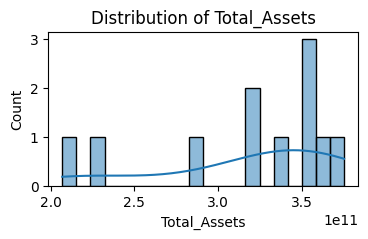

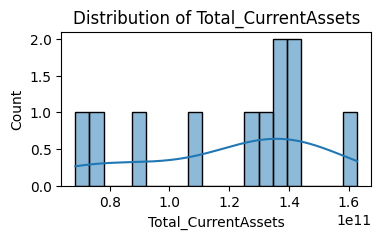

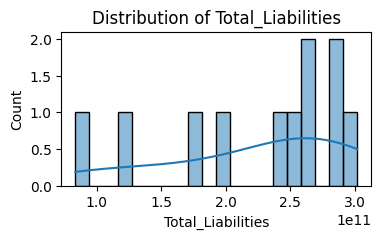

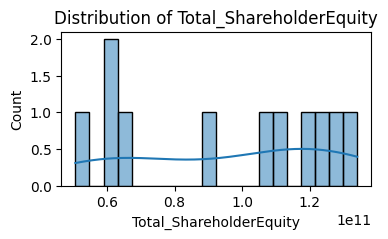

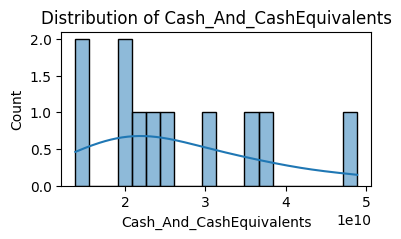

...

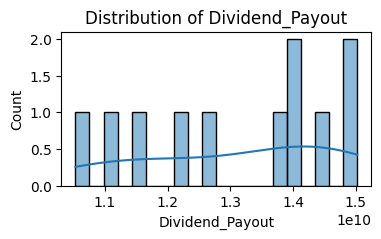

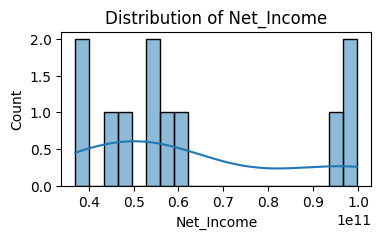

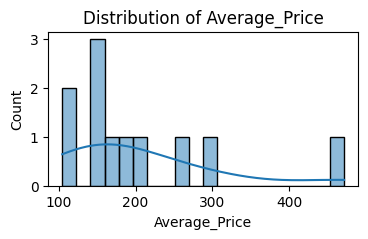

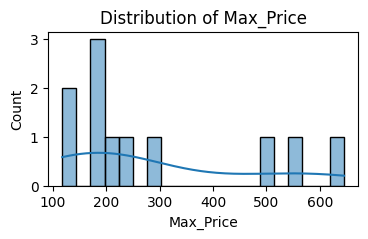

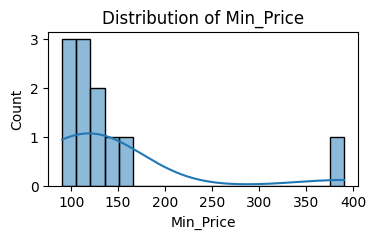

In [17]:
import seaborn as sns
# Distribution of numerical features
numeric_features = selected_df.select_dtypes(include=[np.number]).columns
for feature in numeric_features:
    plt.figure(figsize=(4, 2))
    sns.histplot(selected_df[feature], bins=20, kde=True)
    plt.title(f'Distribution of {feature}')
    plt.show()

In [18]:
pip install seaborn 

Note: you may need to restart the kernel to use updated packages.


C:\Users\Evelyn\AppData\Local\Temp\ipykernel_22644\2449256434.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selected_df['Year'] = pd.to_datetime(selected_df['Year'])


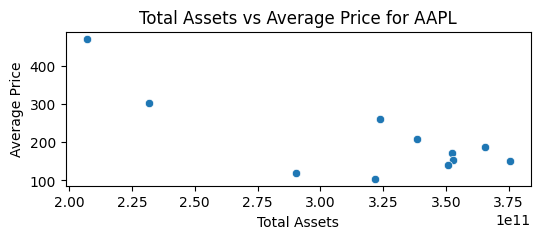

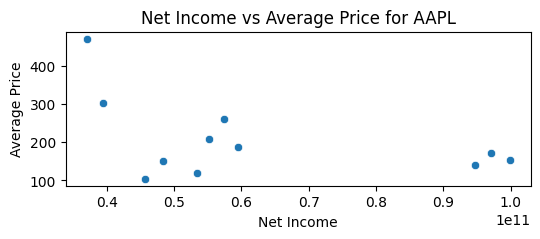

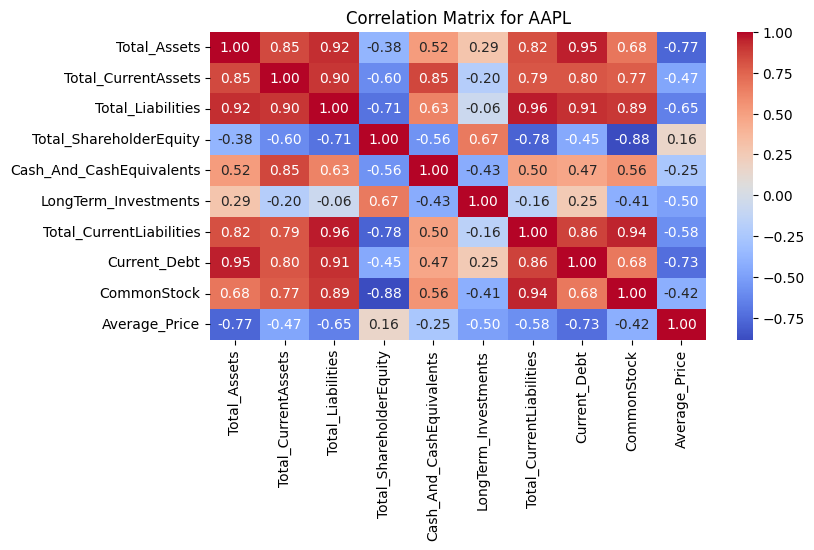

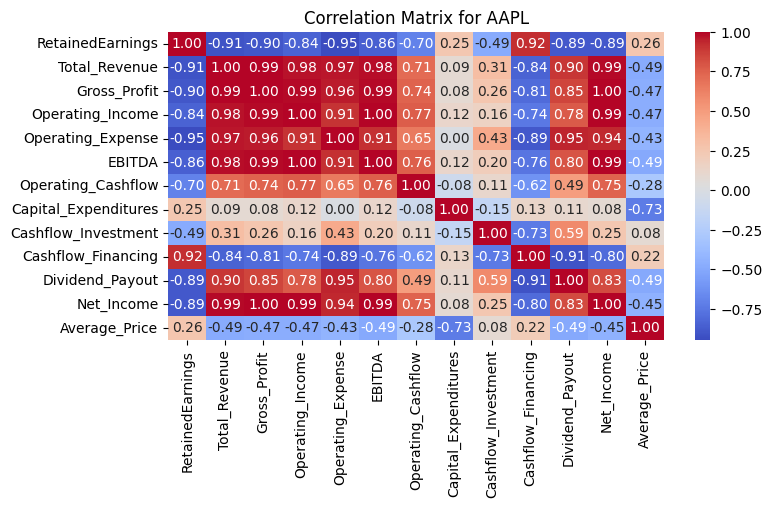

In [19]:
import seaborn as sns
#take AAPL for example
selected_df['Year'] = pd.to_datetime(selected_df['Year'])
    
    # Scatter plot of 'Average_Price' vs other variables
plt.figure(figsize=(6, 2))
sns.scatterplot(data=selected_df, x='Total_Assets', y='Average_Price')
plt.title(f'Total Assets vs Average Price for AAPL')
plt.xlabel('Total Assets')
plt.ylabel('Average Price')
plt.show()

plt.figure(figsize=(6, 2))
sns.scatterplot(data=selected_df, x='Net_Income', y='Average_Price')
plt.title(f'Net Income vs Average Price for AAPL')
plt.xlabel('Net Income')
plt.ylabel('Average Price')
plt.show()



# You can also calculate and visualize correlations
correlation_matrix = selected_df[['Total_Assets','Total_CurrentAssets','Total_Liabilities','Total_ShareholderEquity','Cash_And_CashEquivalents','LongTerm_Investments','Total_CurrentLiabilities'	,'Current_Debt'	,'CommonStock','Average_Price']].corr()
correlation_matrix1 = selected_df[['RetainedEarnings','Total_Revenue','Gross_Profit','Operating_Income'	,'Operating_Expense','EBITDA','Operating_Cashflow','Capital_Expenditures','Cashflow_Investment','Cashflow_Financing','Dividend_Payout','Net_Income','Average_Price']].corr()
plt.figure(figsize=(8, 4))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title(f'Correlation Matrix for AAPL')
plt.show()

plt.figure(figsize=(8, 4))
sns.heatmap(correlation_matrix1, annot=True, cmap='coolwarm', fmt=".2f")
plt.title(f'Correlation Matrix for AAPL')
plt.show()

In [20]:
#drop columns with correlation less than 0.3 
columns_to_drop = ['Total_ShareholderEquity', 'Cash_And_CashEquivalents', 'LongTerm_Investments','Cashflow_Investment','Cashflow_Financing']

# Drop the specified columns
AAPL_Column_df = selected_df.drop(columns=columns_to_drop)


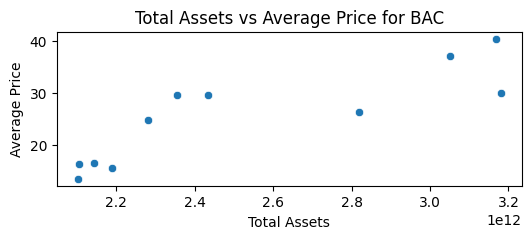

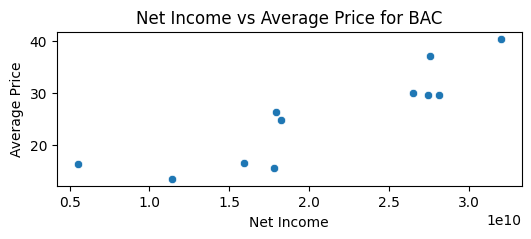

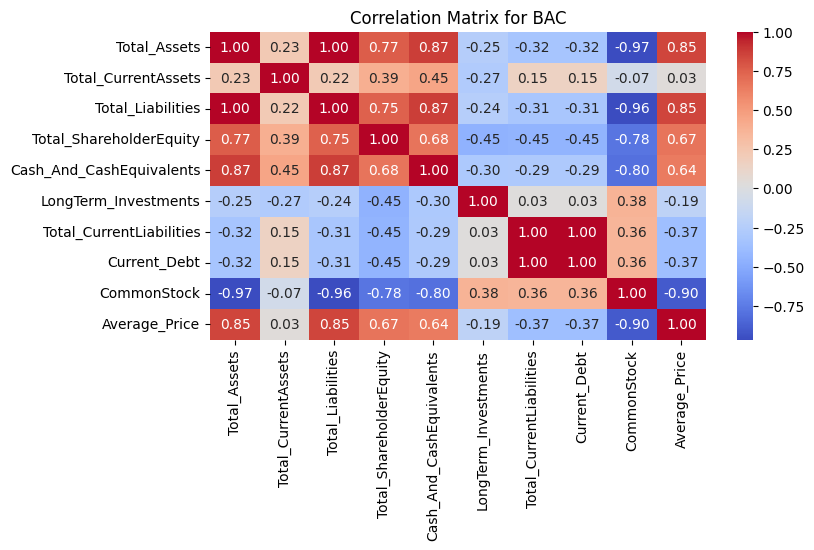

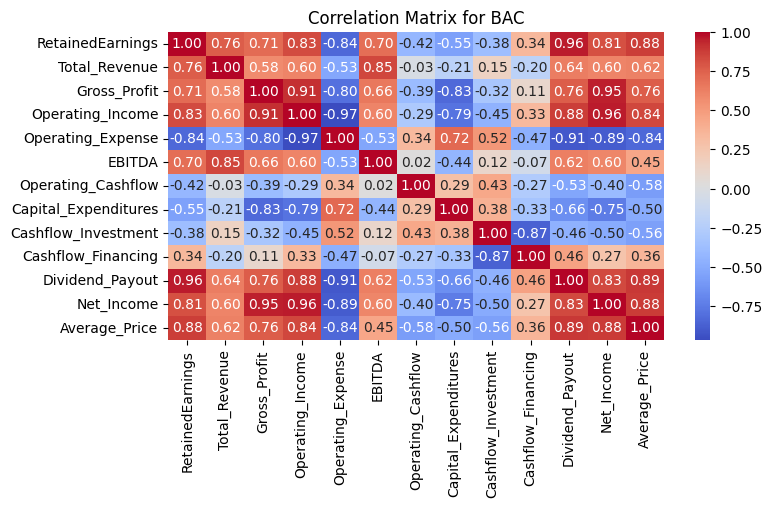

In [21]:
#BAC
import seaborn as sns
#take AAPL for example
clean_df['Year'] = pd.to_datetime(clean_df['Year'])

ticker_df = clean_df[clean_df['Ticker'] == 'BAC']
    
    # Scatter plot of 'Average_Price' vs other variables
plt.figure(figsize=(6, 2))
sns.scatterplot(data=ticker_df, x='Total_Assets', y='Average_Price')
plt.title(f'Total Assets vs Average Price for BAC')
plt.xlabel('Total Assets')
plt.ylabel('Average Price')
plt.show()

plt.figure(figsize=(6, 2))
sns.scatterplot(data=ticker_df, x='Net_Income', y='Average_Price')
plt.title(f'Net Income vs Average Price for BAC')
plt.xlabel('Net Income')
plt.ylabel('Average Price')
plt.show()



# You can also calculate and visualize correlations
correlation_matrix = ticker_df[['Total_Assets','Total_CurrentAssets','Total_Liabilities','Total_ShareholderEquity','Cash_And_CashEquivalents','LongTerm_Investments','Total_CurrentLiabilities'	,'Current_Debt'	,'CommonStock','Average_Price']].corr()
correlation_matrix1 = ticker_df[['RetainedEarnings','Total_Revenue','Gross_Profit','Operating_Income'	,'Operating_Expense','EBITDA','Operating_Cashflow','Capital_Expenditures','Cashflow_Investment','Cashflow_Financing','Dividend_Payout','Net_Income','Average_Price']].corr()
plt.figure(figsize=(8, 4))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title(f'Correlation Matrix for BAC')
plt.show()

plt.figure(figsize=(8, 4))
sns.heatmap(correlation_matrix1, annot=True, cmap='coolwarm', fmt=".2f")
plt.title(f'Correlation Matrix for BAC')
plt.show()

ADBE EDA

In [22]:
selected_df = clean_df[clean_df['Ticker']=='ADBE']

selected_df

selected_df.head()


,Ticker,Year,Total_Assets,Total_CurrentAssets,Total_Liabilities,Total_ShareholderEquity,Cash_And_CashEquivalents,LongTerm_Investments,Total_CurrentLiabilities,Current_Debt,...,EBITDA,Operating_Cashflow,Capital_Expenditures,Cashflow_Investment,Cashflow_Financing,Dividend_Payout,Net_Income,Average_Price,Max_Price,Min_Price
21,ADBE,2023-12-01,2.977900e+10,1.108400e+10,1.326100e+10,1.651800e+10,7.141000e+09,0.0,8.251000e+09,0.000000e+00,...,7.522000e+09,7.302000e+09,360000000.0,7.760000e+08,-5.182000e+09,1.860000e+08,5.428000e+09,466.763076,619.43,320.54
22,ADBE,2022-12-02,2.716500e+10,8.996000e+09,1.311400e+10,1.405100e+10,4.236000e+09,0.0,8.128000e+09,5.000000e+08,...,6.714000e+09,7.838000e+09,442000000.0,-5.700000e+08,-6.825000e+09,0.000000e+00,4.756000e+09,393.588076,520.60,275.20
23,ADBE,2021-12-03,2.724100e+10,8.669000e+09,1.244400e+10,1.479700e+10,3.844000e+09,0.0,6.932000e+09,0.000000e+00,...,6.379000e+09,7.230000e+09,348000000.0,-3.537000e+09,-4.301000e+09,0.000000e+00,4.822000e+09,561.871923,688.37,440.83
24,ADBE,2020-11-27,2.428400e+10,8.146000e+09,1.102000e+10,1.326400e+10,4.478000e+09,0.0,5.512000e+09,0.000000e+00,...,4.851000e+09,5.727000e+09,419000000.0,-4.140000e+08,-3.488000e+09,2.977000e+09,5.260000e+09,416.349433,516.44,293.61
25,ADBE,2019-11-29,2.076200e+10,6.495000e+09,1.023200e+10,1.053000e+10,2.650000e+09,0.0,8.191000e+09,3.149000e+09,...,3.937400e+09,4.422000e+09,394479000.0,-4.560000e+08,-2.946000e+09,0.000000e+00,2.951000e+09,279.864230,330.79,226.19


In [23]:
selected_df.info()


<class 'pandas.core.frame.DataFrame'>
Index: 11 entries, 21 to 31
Data columns (total 26 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   Ticker                    11 non-null     object        
 1   Year                      11 non-null     datetime64[ns]
 2   Total_Assets              11 non-null     float64       
 3   Total_CurrentAssets       11 non-null     float64       
 4   Total_Liabilities         11 non-null     float64       
 5   Total_ShareholderEquity   11 non-null     float64       
 6   Cash_And_CashEquivalents  11 non-null     float64       
 7   LongTerm_Investments      11 non-null     float64       
 8   Total_CurrentLiabilities  11 non-null     float64       
 9   Current_Debt              11 non-null     float64       
 10  RetainedEarnings          11 non-null     float64       
 11  CommonStock               11 non-null     float64       
 12  Total_Revenue             11

In [24]:
selected_df.describe()

,Year,Total_Assets,Total_CurrentAssets,Total_Liabilities,Total_ShareholderEquity,Cash_And_CashEquivalents,LongTerm_Investments,Total_CurrentLiabilities,Current_Debt,RetainedEarnings,...,EBITDA,Operating_Cashflow,Capital_Expenditures,Cashflow_Investment,Cashflow_Financing,Dividend_Payout,Net_Income,Average_Price,Max_Price,Min_Price
count,11,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,...,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,1.100000e+01,11.000000,11.000000,11.000000
mean,2018-11-30 00:00:00,1.892046e+10,6.800434e+09,8.474195e+09,1.044618e+10,2.739803e+09,4.077782e+07,4.898896e+09,3.879005e+08,1.551097e+10,...,3.606022e+09,4.142659e+09,2.848737e+08,-1.222343e+09,-2.389868e+09,5.934651e+08,2.714424e+09,253.716076,315.910909,190.352727
min,2013-11-29 00:00:00,1.038030e+10,4.045929e+09,3.655664e+09,6.724634e+09,8.345560e+08,0.000000e+00,1.525648e+09,0.000000e+00,6.924294e+09,...,7.180080e+08,1.151686e+09,1.483320e+08,-4.685000e+09,-6.825000e+09,0.000000e+00,2.683950e+08,46.918653,60.890000,37.980000
25%,2016-05-30 12:00:00,1.221186e+10,4.839466e+09,4.998652e+09,7.213208e+09,1.064358e+09,0.000000e+00,2.653035e+09,0.000000e+00,7.683974e+09,...,1.537172e+09,1.834615e+09,1.866470e+08,-1.333080e+09,-3.894500e+09,0.000000e+00,8.991665e+08,89.190721,101.665000,73.400000
50%,2018-11-30 00:00:00,1.876868e+10,6.495000e+09,9.406568e+09,9.362000e+09,2.306000e+09,0.000000e+00,4.301126e+09,0.000000e+00,1.181560e+10,...,3.222700e+09,4.029000e+09,2.665790e+08,-5.700000e+08,-1.183735e+09,7.456900e+07,2.591000e+09,234.796538,274.690000,185.340000
75%,2021-05-31 12:00:00,2.572450e+10,8.407500e+09,1.173200e+10,1.365750e+10,4.040000e+09,8.043900e+07,7.530000e+09,2.573380e+08,2.175800e+10,...,5.615000e+09,6.478500e+09,3.772395e+08,-4.494385e+08,-5.332105e+08,5.413020e+08,4.789000e+09,404.968754,518.520000,284.405000
max,2023-12-01 00:00:00,2.977900e+10,1.108400e+10,1.326100e+10,1.651800e+10,7.141000e+09,2.072390e+08,8.251000e+09,3.149000e+09,3.334600e+10,...,7.522000e+09,7.838000e+09,4.420000e+08,7.760000e+08,-5.000000e+06,2.977000e+09,5.428000e+09,561.871923,688.370000,440.830000
std,NaN,7.321949e+09,2.231551e+09,3.792762e+09,3.608011e+09,1.999261e+09,6.638386e+07,2.607244e+09,9.420811e+08,9.428946e+09,...,2.470207e+09,2.555403e+09,1.098044e+08,1.558579e+09,2.305480e+09,1.044148e+09,2.053353e+09,181.922891,233.806215,131.687289


C:\Users\Evelyn\AppData\Local\Temp\ipykernel_22644\1876238084.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selected_df['Year'] = pd.to_datetime(selected_df['Year'])


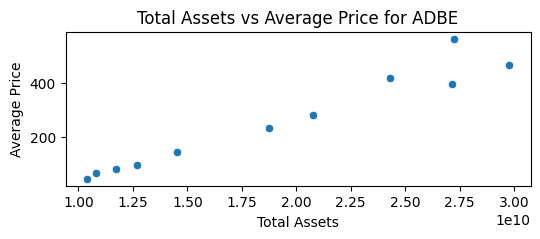

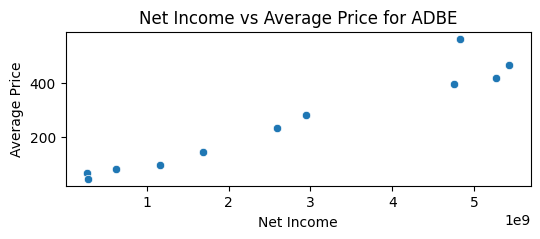

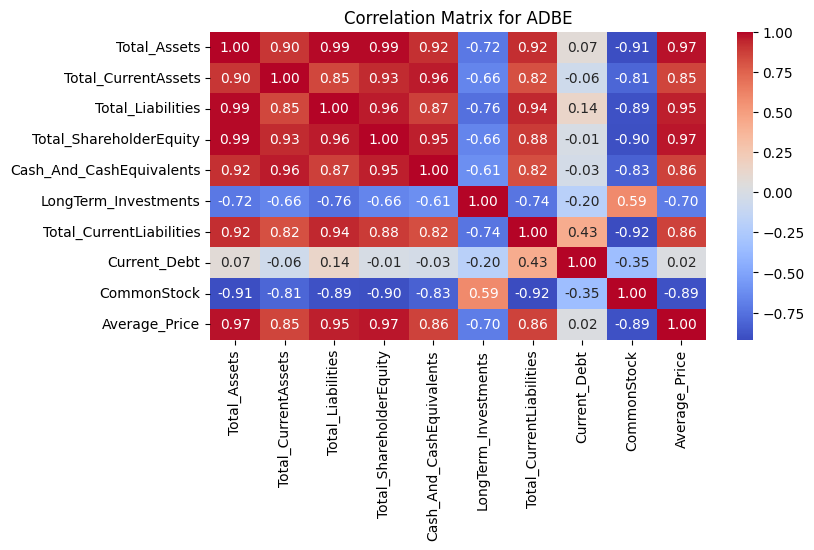

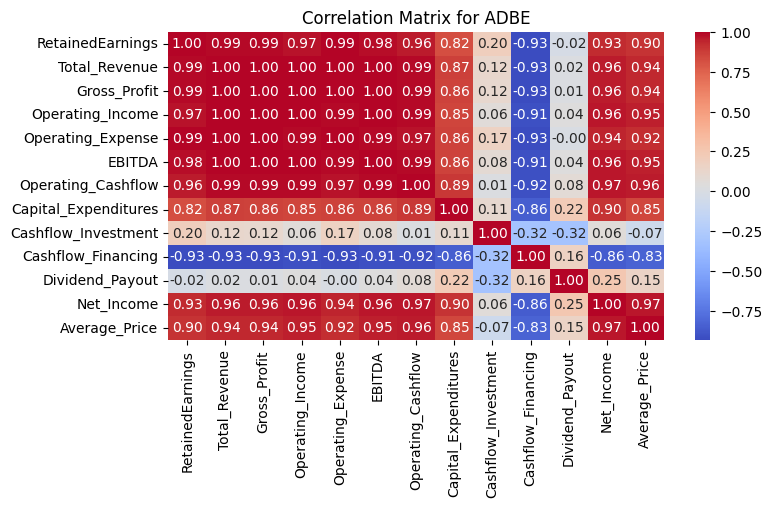

In [25]:
import seaborn as sns
#take AAPL for example
selected_df['Year'] = pd.to_datetime(selected_df['Year'])
    
    # Scatter plot of 'Average_Price' vs other variables
plt.figure(figsize=(6, 2))
sns.scatterplot(data=selected_df, x='Total_Assets', y='Average_Price')
plt.title(f'Total Assets vs Average Price for ADBE')
plt.xlabel('Total Assets')
plt.ylabel('Average Price')
plt.show()

plt.figure(figsize=(6, 2))
sns.scatterplot(data=selected_df, x='Net_Income', y='Average_Price')
plt.title(f'Net Income vs Average Price for ADBE')
plt.xlabel('Net Income')
plt.ylabel('Average Price')
plt.show()



# You can also calculate and visualize correlations
correlation_matrix = selected_df[['Total_Assets','Total_CurrentAssets','Total_Liabilities','Total_ShareholderEquity','Cash_And_CashEquivalents','LongTerm_Investments','Total_CurrentLiabilities'	,'Current_Debt'	,'CommonStock','Average_Price']].corr()
correlation_matrix1 = selected_df[['RetainedEarnings','Total_Revenue','Gross_Profit','Operating_Income'	,'Operating_Expense','EBITDA','Operating_Cashflow','Capital_Expenditures','Cashflow_Investment','Cashflow_Financing','Dividend_Payout','Net_Income','Average_Price']].corr()
plt.figure(figsize=(8, 4))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title(f'Correlation Matrix for ADBE')
plt.show()

plt.figure(figsize=(8, 4))
sns.heatmap(correlation_matrix1, annot=True, cmap='coolwarm', fmt=".2f")
plt.title(f'Correlation Matrix for ADBE')
plt.show()

In [26]:
#drop columns with correlation less than 0.3 
columns_to_drop = ['Current_Debt', 'Dividend_Payout','Cashflow_Investment']

# Drop the specified columns
ADBE_Column_df = selected_df.drop(columns=columns_to_drop)
ADBE_Column_df

,Ticker,Year,Total_Assets,Total_CurrentAssets,Total_Liabilities,Total_ShareholderEquity,Cash_And_CashEquivalents,LongTerm_Investments,Total_CurrentLiabilities,RetainedEarnings,...,Operating_Income,Operating_Expense,EBITDA,Operating_Cashflow,Capital_Expenditures,Cashflow_Financing,Net_Income,Average_Price,Max_Price,Min_Price
21,ADBE,2023-12-01,2.977900e+10,1.108400e+10,1.326100e+10,1.651800e+10,7.141000e+09,0.0,8.251000e+09,3.334600e+10,...,6.650000e+09,1.040500e+10,7.522000e+09,7.302000e+09,360000000.0,-5.182000e+09,5.428000e+09,466.763076,619.43,320.54
22,ADBE,2022-12-02,2.716500e+10,8.996000e+09,1.311400e+10,1.405100e+10,4.236000e+09,0.0,8.128000e+09,2.831900e+10,...,6.098000e+09,9.343000e+09,6.714000e+09,7.838000e+09,442000000.0,-6.825000e+09,4.756000e+09,393.588076,520.60,275.20
23,ADBE,2021-12-03,2.724100e+10,8.669000e+09,1.244400e+10,1.479700e+10,3.844000e+09,0.0,6.932000e+09,2.390500e+10,...,5.802000e+09,8.118000e+09,6.379000e+09,7.230000e+09,348000000.0,-4.301000e+09,4.822000e+09,561.871923,688.37,440.83
24,ADBE,2020-11-27,2.428400e+10,8.146000e+09,1.102000e+10,1.326400e+10,4.478000e+09,0.0,5.512000e+09,1.961100e+10,...,4.237000e+09,6.909000e+09,4.851000e+09,5.727000e+09,419000000.0,-3.488000e+09,5.260000e+09,416.349433,516.44,293.61
25,ADBE,2019-11-29,2.076200e+10,6.495000e+09,1.023200e+10,1.053000e+10,2.650000e+09,0.0,8.191000e+09,1.482900e+10,...,3.268000e+09,6.230000e+09,3.937400e+09,4.422000e+09,394479000.0,-2.946000e+09,2.951000e+09,279.864230,330.79,226.19
26,ADBE,2018-11-30,1.876868e+10,4.857039e+09,9.406568e+09,9.362000e+09,1.643000e+09,0.0,4.301126e+09,1.181560e+10,...,2.840000e+09,4.995000e+09,3.222700e+09,4.029000e+09,266579000.0,-5.000000e+06,2.591000e+09,234.796538,274.69,185.34
27,ADBE,2017-12-01,1.453556e+10,7.247813e+09,6.075687e+09,8.459000e+09,2.306000e+09,0.0,3.527457e+09,9.573870e+09,...,2.168095e+09,4.122919e+09,2.522543e+09,2.912853e+09,178122000.0,-1.183735e+09,1.693954e+09,144.800576,184.46,108.30
28,ADBE,2016-12-02,1.269725e+10,5.839774e+09,5.272411e+09,7.424835e+09,1.011315e+09,80439000.0,2.811635e+09,8.114517e+09,...,1.493602e+09,3.540920e+09,1.815580e+09,2.199728e+09,203805000.0,-1.090706e+09,1.168782e+09,97.236538,109.03,76.67
29,ADBE,2015-11-27,1.172647e+10,4.821892e+09,4.724892e+09,7.001580e+09,8.765600e+08,80439000.0,2.213556e+09,7.253431e+09,...,9.030950e+08,3.148099e+09,1.258765e+09,1.469502e+09,184936000.0,-2.006870e+08,6.295510e+08,81.144905,94.30,70.13
30,ADBE,2014-11-28,1.078583e+10,4.602328e+09,4.009924e+09,6.775905e+09,1.117400e+09,80439000.0,2.494435e+09,6.924294e+09,...,4.126850e+08,3.112300e+09,7.180080e+08,1.287482e+09,148332000.0,-5.072830e+08,2.683950e+08,67.542884,76.02,59.09


COST EDA

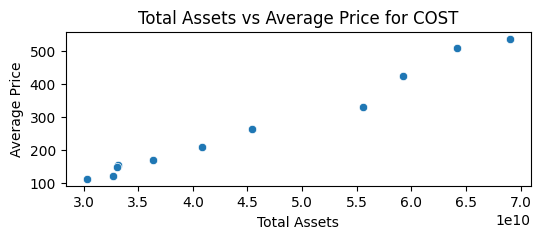

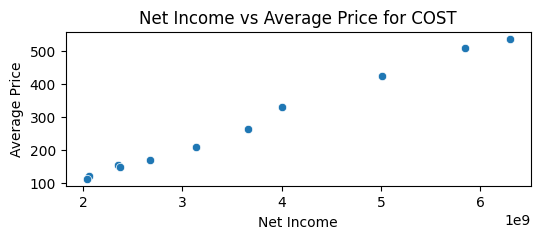

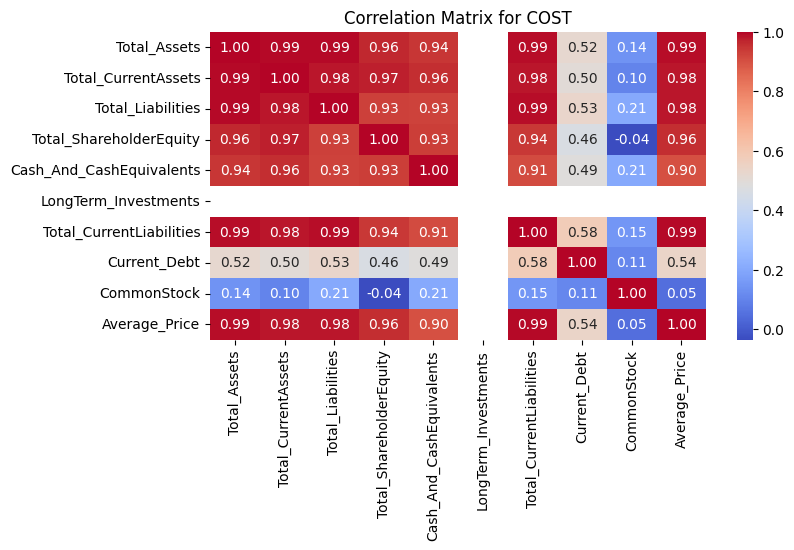

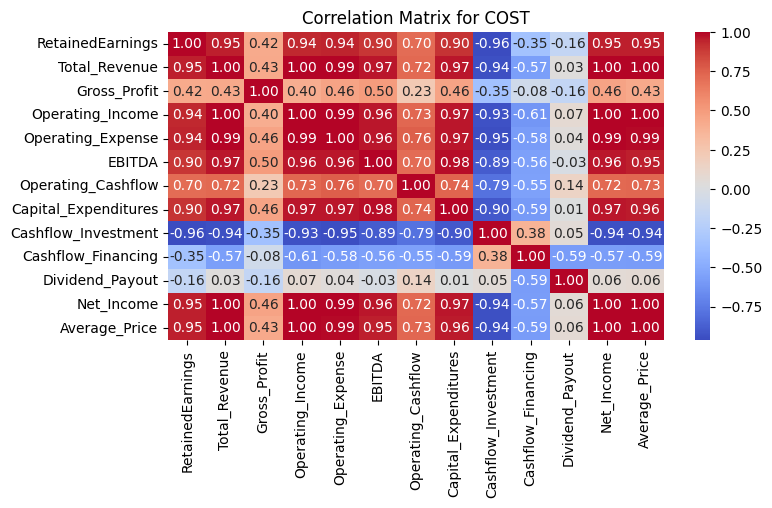

In [27]:
#COST
import seaborn as sns
#take AAPL for example
clean_df['Year'] = pd.to_datetime(clean_df['Year'])

ticker_df = clean_df[clean_df['Ticker'] == 'COST']
    
    # Scatter plot of 'Average_Price' vs other variables
plt.figure(figsize=(6, 2))
sns.scatterplot(data=ticker_df, x='Total_Assets', y='Average_Price')
plt.title(f'Total Assets vs Average Price for COST')
plt.xlabel('Total Assets')
plt.ylabel('Average Price')
plt.show()

plt.figure(figsize=(6, 2))
sns.scatterplot(data=ticker_df, x='Net_Income', y='Average_Price')
plt.title(f'Net Income vs Average Price for COST')
plt.xlabel('Net Income')
plt.ylabel('Average Price')
plt.show()



# You can also calculate and visualize correlations
correlation_matrix = ticker_df[['Total_Assets','Total_CurrentAssets','Total_Liabilities','Total_ShareholderEquity','Cash_And_CashEquivalents','LongTerm_Investments','Total_CurrentLiabilities'	,'Current_Debt'	,'CommonStock','Average_Price']].corr()
correlation_matrix1 = ticker_df[['RetainedEarnings','Total_Revenue','Gross_Profit','Operating_Income'	,'Operating_Expense','EBITDA','Operating_Cashflow','Capital_Expenditures','Cashflow_Investment','Cashflow_Financing','Dividend_Payout','Net_Income','Average_Price']].corr()
plt.figure(figsize=(8, 4))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title(f'Correlation Matrix for COST')
plt.show()

plt.figure(figsize=(8, 4))
sns.heatmap(correlation_matrix1, annot=True, cmap='coolwarm', fmt=".2f")
plt.title(f'Correlation Matrix for COST')
plt.show()

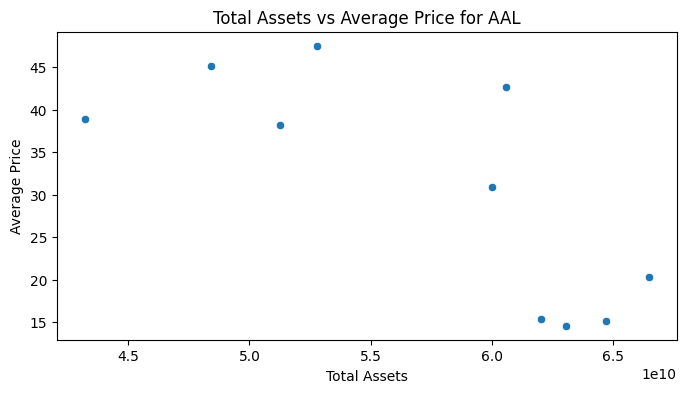

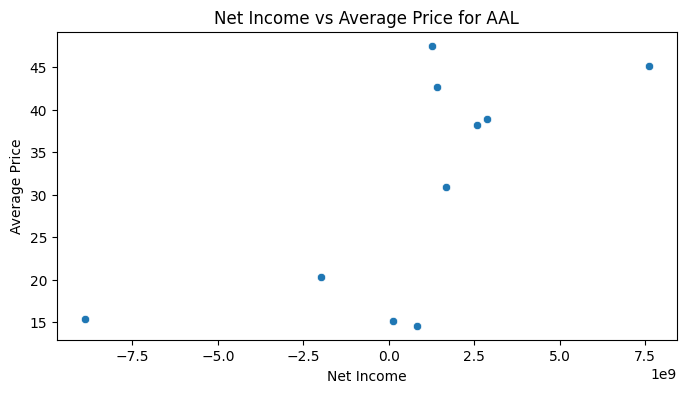

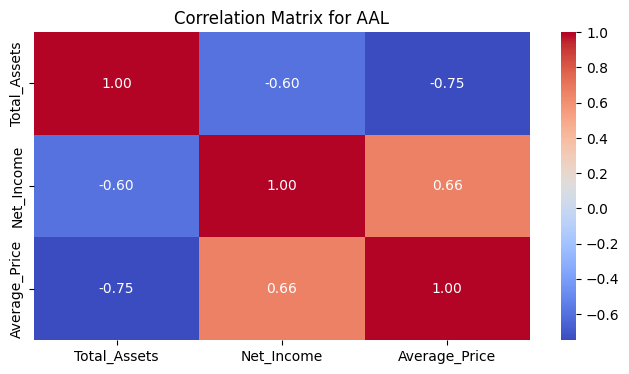

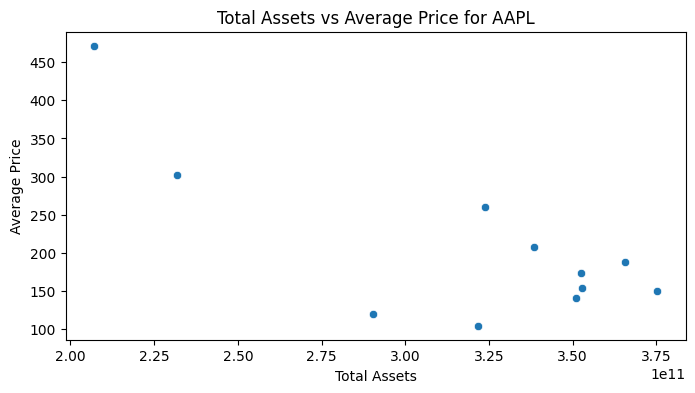

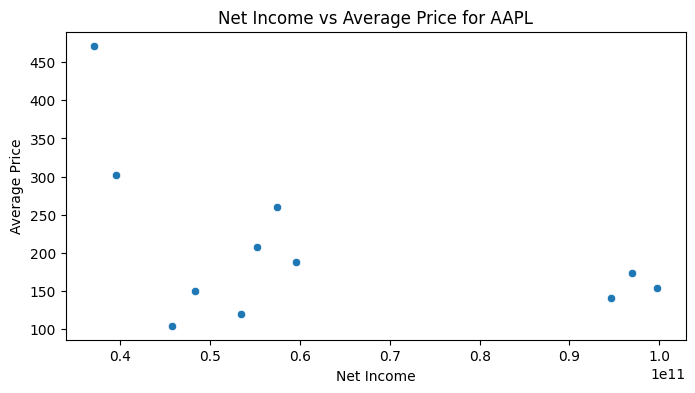

...

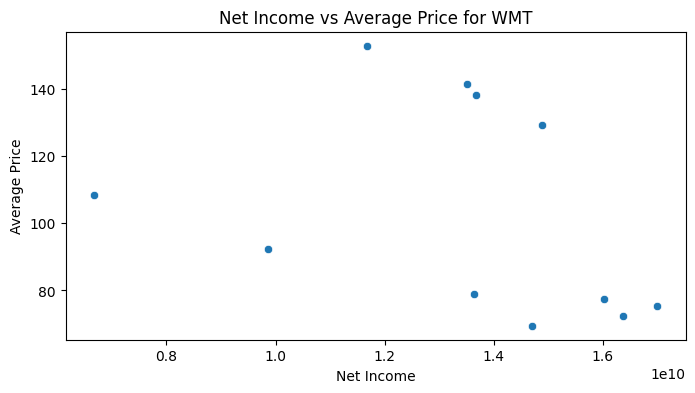

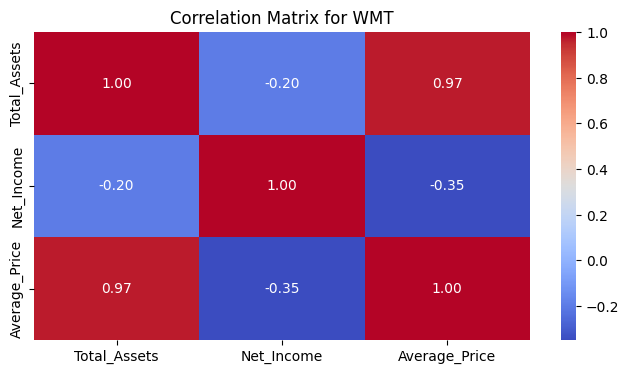

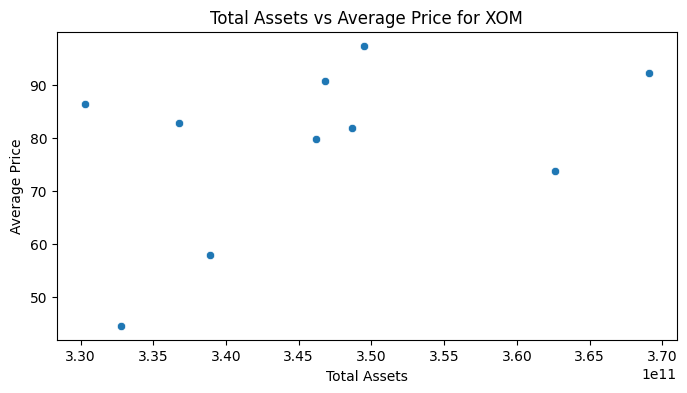

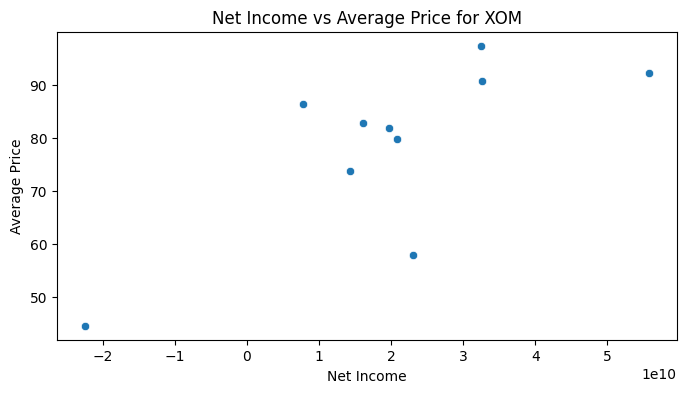

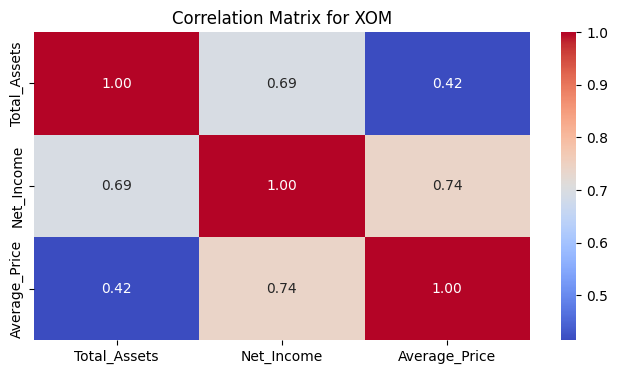

In [28]:
import seaborn as sns
# Convert the 'Year' column to datetime type
clean_df['Year'] = pd.to_datetime(clean_df['Year'])

# Perform EDA for each ticker separately
tickers = clean_df['Ticker'].unique()
for ticker in tickers:
    ticker_df = clean_df[clean_df['Ticker'] == ticker]
    
    # Scatter plot of 'Average_Price' vs other variables
    plt.figure(figsize=(8, 4))
    sns.scatterplot(data=ticker_df, x='Total_Assets', y='Average_Price')
    plt.title(f'Total Assets vs Average Price for {ticker}')
    plt.xlabel('Total Assets')
    plt.ylabel('Average Price')
    plt.show()

    plt.figure(figsize=(8, 4))
    sns.scatterplot(data=ticker_df, x='Net_Income', y='Average_Price')
    plt.title(f'Net Income vs Average Price for {ticker}')
    plt.xlabel('Net Income')
    plt.ylabel('Average Price')
    plt.show()


    # You can also calculate and visualize correlations
    correlation_matrix = ticker_df[['Total_Assets', 'Net_Income', 'Average_Price']].corr()
    plt.figure(figsize=(8, 4))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
    plt.title(f'Correlation Matrix for {ticker}')
    plt.show()

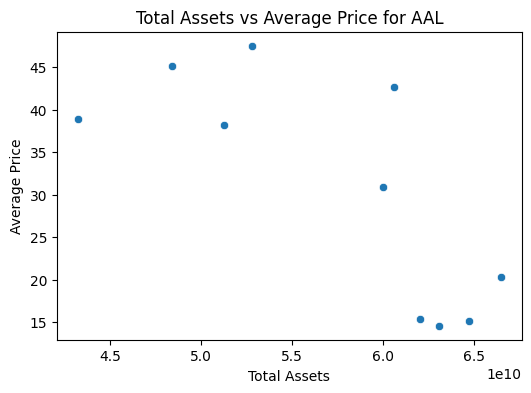

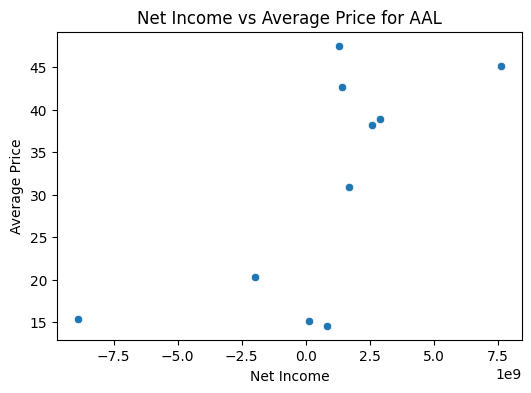

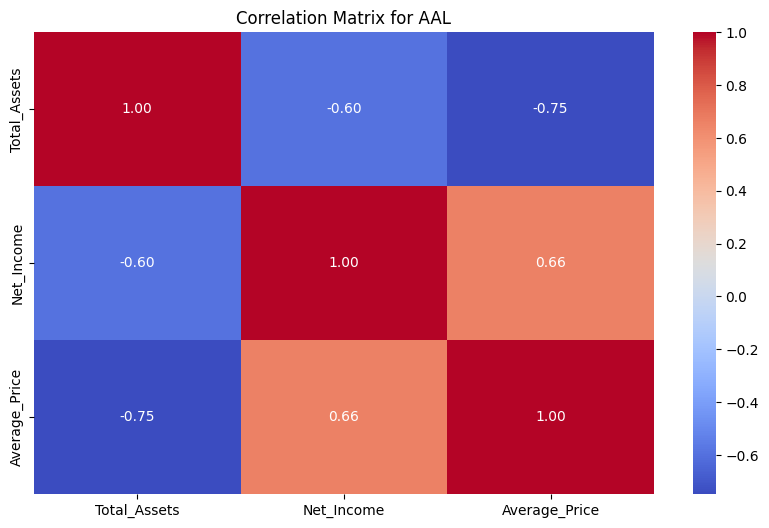

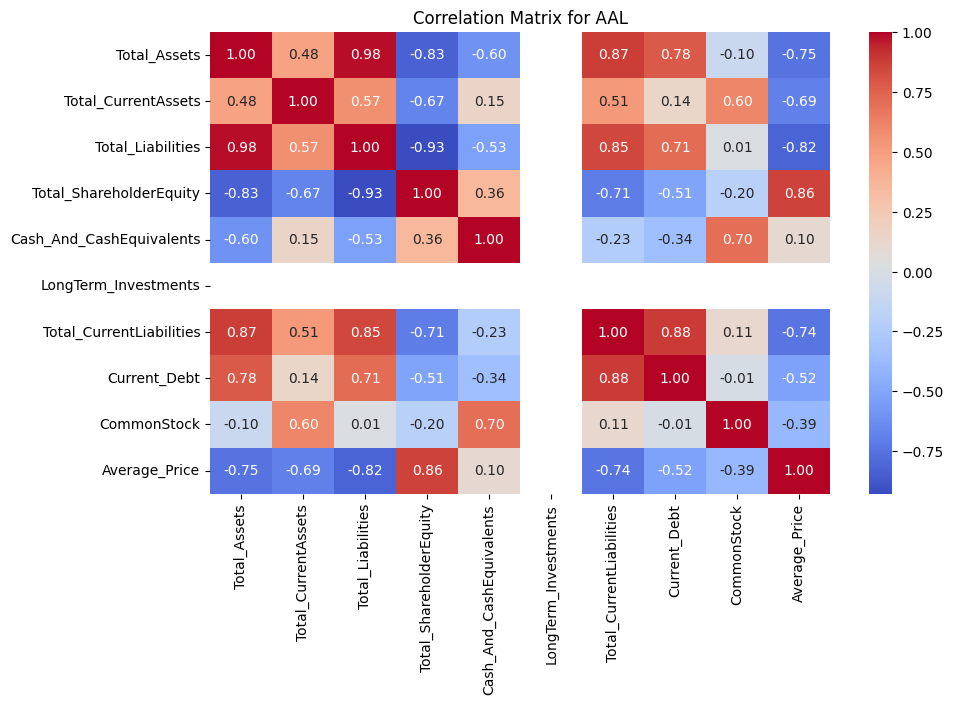

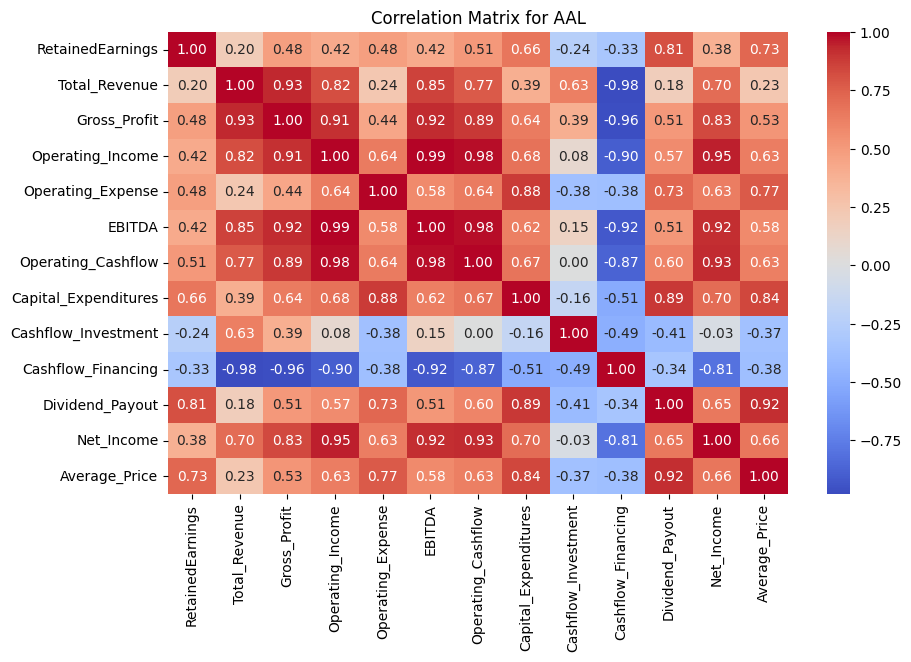

...

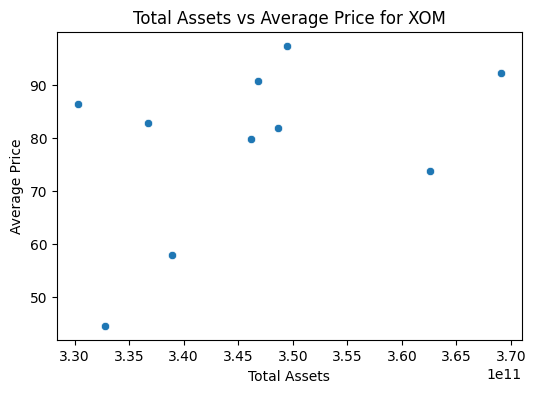

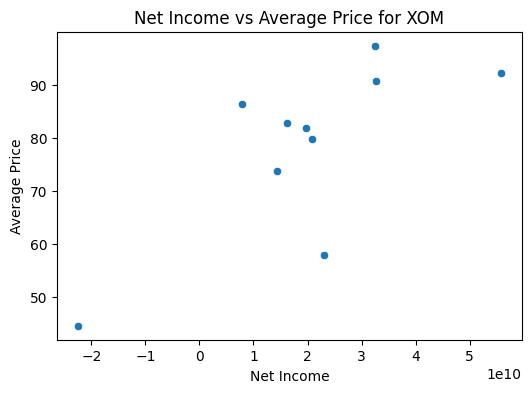

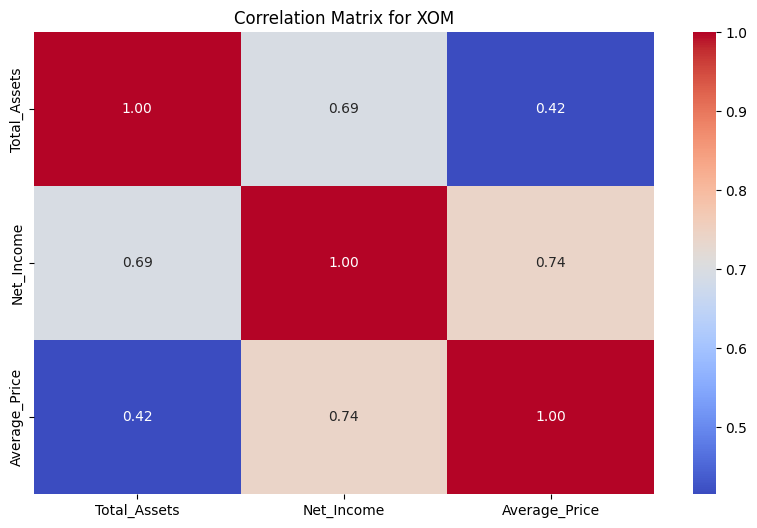

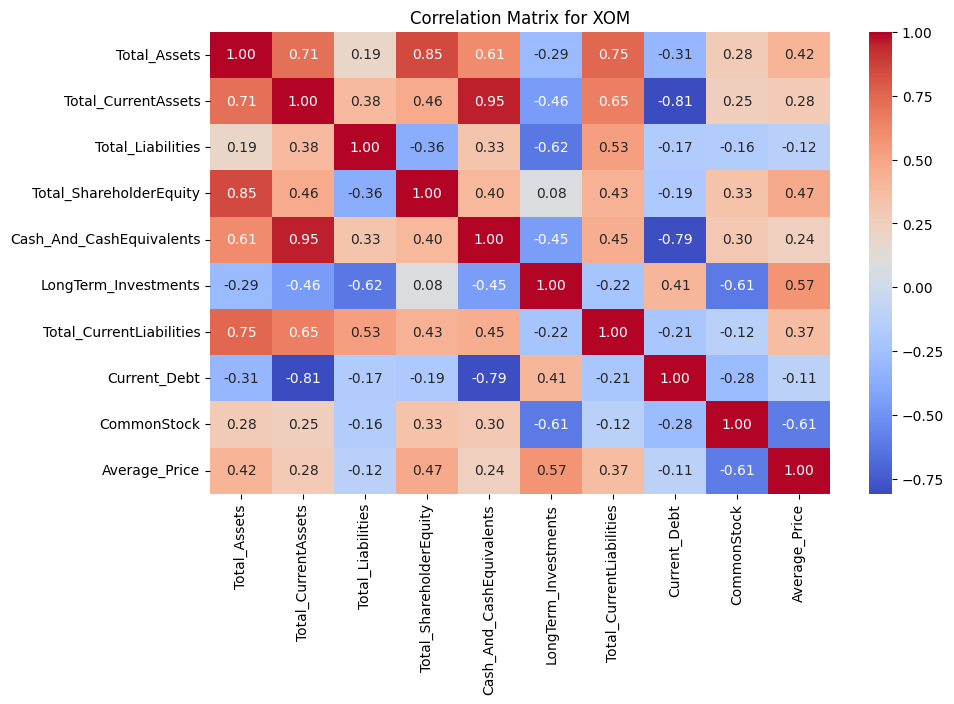

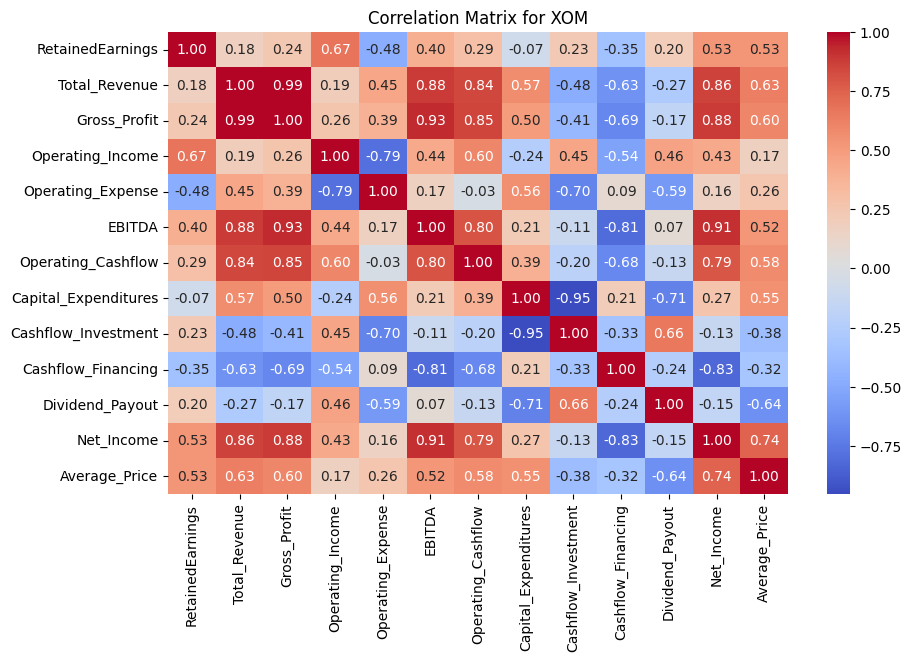

In [39]:



symbols_list = clean_df['Ticker'].tolist()
symbols_list = list(set(symbols_list))
symbols_list = sorted(symbols_list)

for symbol in symbols_list :
    symbol_df=clean_df[clean_df['Ticker']==symbol]
    
 # Scatter plot of 'Average_Price' vs other variables
    plt.figure(figsize=(6, 4))
    sns.scatterplot(data=symbol_df, x='Total_Assets', y='Average_Price')
    plt.title(f'Total Assets vs Average Price for {symbol}')
    plt.xlabel('Total Assets')
    plt.ylabel('Average Price')
    plt.show()

    plt.figure(figsize=(6, 4))
    sns.scatterplot(data=symbol_df, x='Net_Income', y='Average_Price')
    plt.title(f'Net Income vs Average Price for {symbol}')
    plt.xlabel('Net Income')
    plt.ylabel('Average Price')
    plt.show()

    # You can also calculate and visualize correlations
    correlation_matrix = symbol_df[['Total_Assets', 'Net_Income', 'Average_Price']].corr()
    correlation_matrix1 = symbol_df[['Total_Assets','Total_CurrentAssets','Total_Liabilities','Total_ShareholderEquity','Cash_And_CashEquivalents','LongTerm_Investments','Total_CurrentLiabilities'	,'Current_Debt'	,'CommonStock','Average_Price']].corr()
    correlation_matrix2 = symbol_df[['RetainedEarnings','Total_Revenue','Gross_Profit','Operating_Income'	,'Operating_Expense','EBITDA','Operating_Cashflow','Capital_Expenditures','Cashflow_Investment','Cashflow_Financing','Dividend_Payout','Net_Income','Average_Price']].corr()
    plt.figure(figsize=(10, 6))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
    plt.title(f'Correlation Matrix for {symbol}')
    plt.show()
    
    plt.figure(figsize=(10, 6))
    sns.heatmap(correlation_matrix1, annot=True, cmap='coolwarm', fmt=".2f")
    plt.title(f'Correlation Matrix for {symbol}')
    plt.show()
    
    plt.figure(figsize=(10, 6))
    sns.heatmap(correlation_matrix2, annot=True, cmap='coolwarm', fmt=".2f")
    plt.title(f'Correlation Matrix for {symbol}')
    plt.show()









In [30]:

selected_tickers = ['AAPL', 'ADBE', 'COST', 'JPM', 'NVDA']
selected_df = clean_df[clean_df['Ticker'].isin(selected_tickers)]

symbols_list = sorted(selected_df['Ticker'].unique())
symbols_list

['AAPL', 'ADBE', 'COST', 'JPM', 'NVDA']

c:\Users\Evelyn\anaconda3\envs\tf\lib\site-packages\sklearn\base.py:486: UserWarning: X has feature names, but LinearRegression was fitted without feature names
  warnings.warn(


symbol:AAPL
Training predictions: [471.48673  141.260192 154.179038 119.755283 208.219423 104.497884
 260.084528 150.5775  ]
Testing Prediction: 108.93971320221372
Training RMSE: 6.833781207288092e-14
Testing RMSE: 108.93971320221372
R-squared: -2.609342813663088
Intercept: 201.25757225
Coefficients: [ 10.72017586  24.22392149 -11.61539453  41.39220926 -85.77408666
 -24.70716401   4.0388376  -29.49031332  23.22345418  16.78020988
  20.55195221  18.58953142  30.72409191  -8.40454285 -16.34759683
 -89.32721758 -87.41944844  55.29405678   7.19957413   0.54585544
  57.70253315]


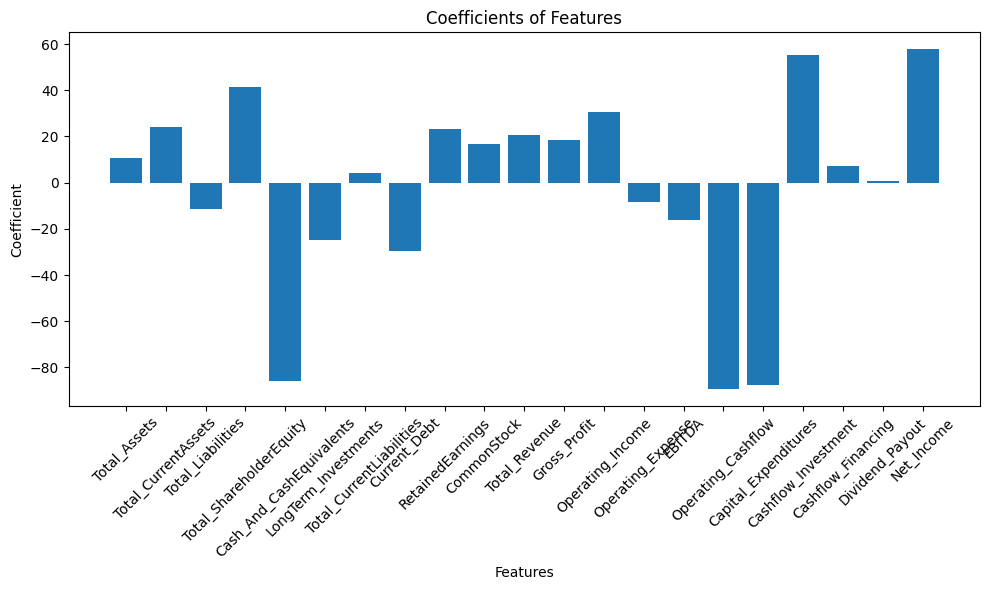

c:\Users\Evelyn\anaconda3\envs\tf\lib\site-packages\sklearn\base.py:486: UserWarning: X has feature names, but LinearRegression was fitted without feature names
  warnings.warn(


symbol:ADBE
Training predictions: [ 46.918653 561.871923 393.588076  81.144905 279.86423   97.236538
 416.349433 144.800576]
Testing Prediction: 71.095487726934
Training RMSE: 1.483869454720626e-13
Testing RMSE: 71.095487726934
R-squared: 0.8113646541422207
Intercept: 252.72179175
Coefficients: [ 20.52902646  35.6398561    9.55054959  32.65461384  28.27983074
  12.77288399   1.85294078   5.42611075 -22.78926865 -31.3720444
  -2.43006827  -1.77003633   9.03443663 -11.41007844   8.52512827
  10.03923358   6.19935096 -44.48425749  28.40457791  -1.25288221
  49.17891801]


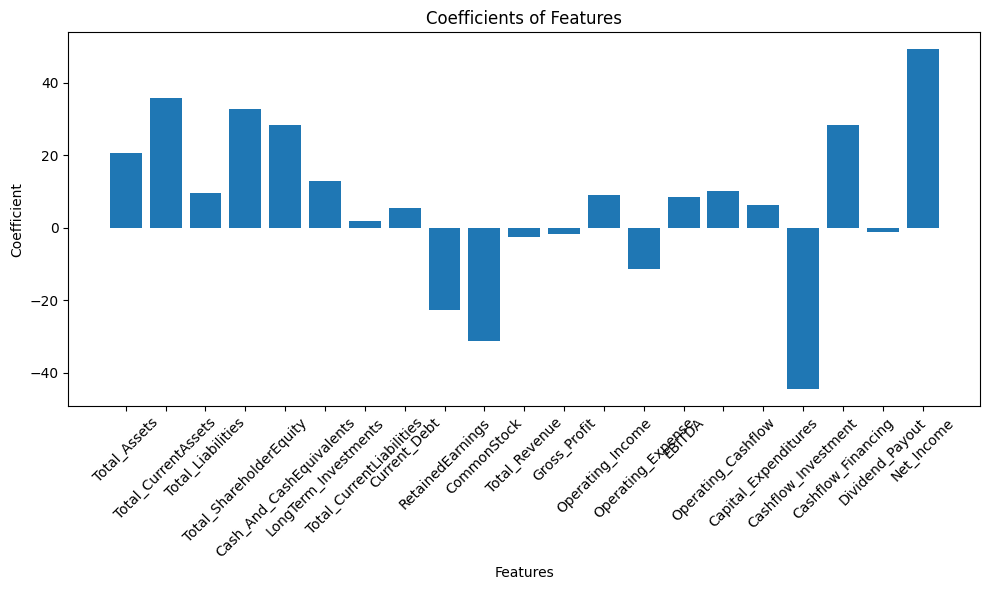

c:\Users\Evelyn\anaconda3\envs\tf\lib\site-packages\sklearn\base.py:486: UserWarning: X has feature names, but LinearRegression was fitted without feature names
  warnings.warn(


symbol:COST
Training predictions: [111.836153 422.941153 508.535769 147.864339 262.218269 154.094038
 329.188301 167.52673 ]
Testing Prediction: 25.361600976490674
Training RMSE: 7.034014214903312e-14
Testing RMSE: 25.361600976490674
R-squared: 0.979817276289282
Intercept: 263.025594
Coefficients: [ 9.74228767e+00  1.02874473e+01  9.61450979e+00  1.01795890e+01
  6.24904763e+00  1.94289029e-16  9.77217662e+00  3.40000598e-01
  1.05043127e+01 -8.84694766e+00  1.16678620e+01 -1.20367199e+00
  1.16926096e+01  9.45977223e+00  9.96467189e+00 -4.07301078e+00
  1.08971520e+01 -8.49022965e+00 -6.63390990e+00  4.45068519e+00
  1.15529604e+01]


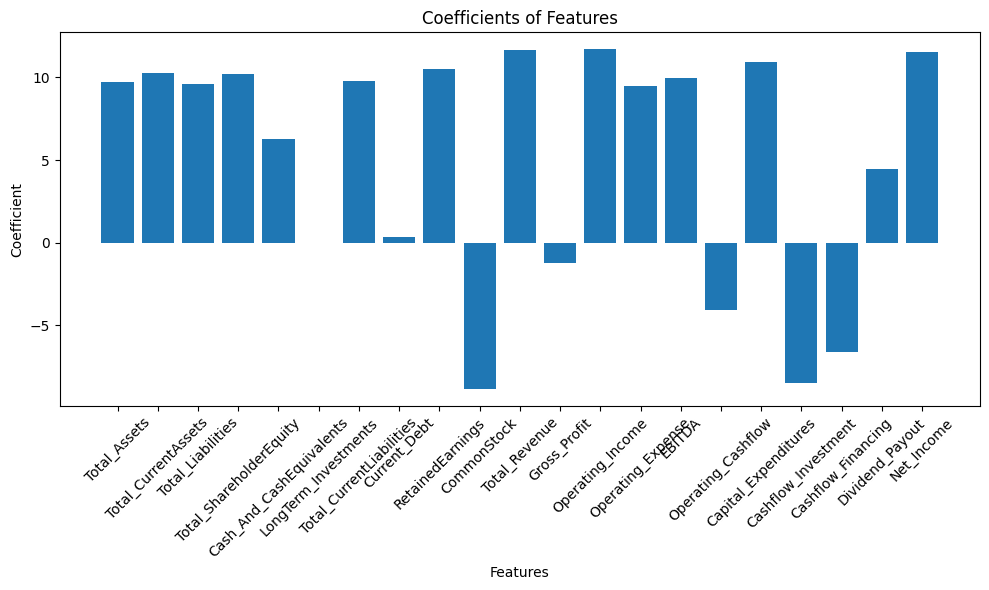

c:\Users\Evelyn\anaconda3\envs\tf\lib\site-packages\sklearn\base.py:486: UserWarning: X has feature names, but LinearRegression was fitted without feature names
  warnings.warn(


symbol:JPM
Training predictions: [ 51.959038 155.9575   127.913653  63.785094 114.023269  65.836153
 107.023962  92.057692]
Testing Prediction: 10.116689068061945
Training RMSE: 1.96205025865255e-14
Testing RMSE: 10.116689068061945
R-squared: 0.9187279844272136
Intercept: 97.31954512499999
Coefficients: [ 0.28879745  2.68348341  0.36225546 -1.15714653  2.34273154  1.79620563
 -5.68530183 -8.11030296  1.76343149  0.          2.23868566  8.8791487
  4.42380604  1.32327577 -1.10197037 -0.70351147  4.4721031   0.69569321
  0.40616681  0.67528861  4.91631384]


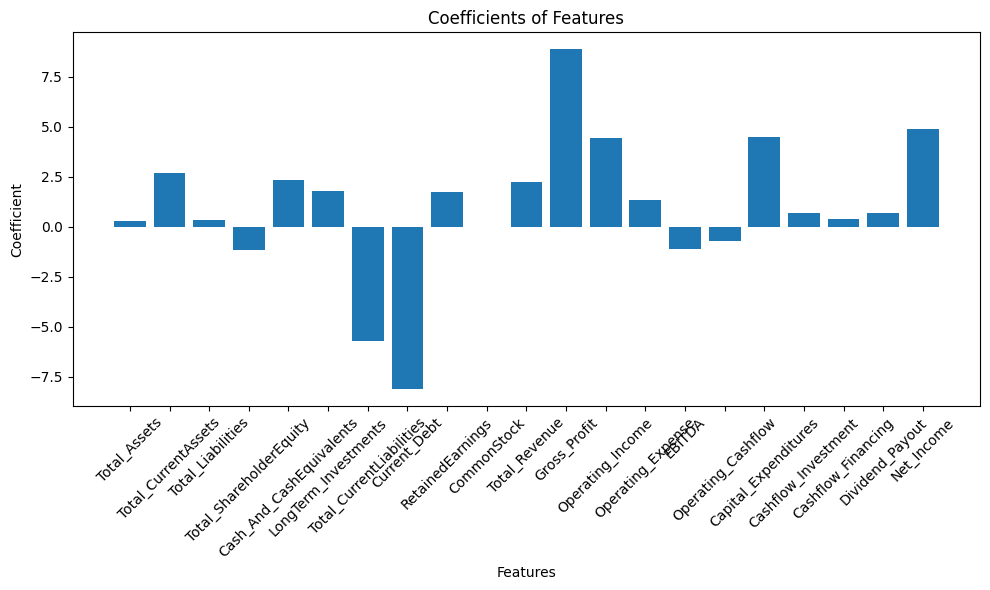

c:\Users\Evelyn\anaconda3\envs\tf\lib\site-packages\sklearn\base.py:486: UserWarning: X has feature names, but LinearRegression was fitted without feature names
  warnings.warn(


symbol:NVDA
Training predictions: [ 14.223653 443.548269 183.984615  23.868301 174.7075    54.448076
 394.986415 149.91673 ]
Testing Prediction: 390.89937108037714
Training RMSE: 5.541966451968028e-13
Testing RMSE: 390.89937108037714
R-squared: -6.4364403055605575
Intercept: 179.960444875
Coefficients: [-11.55248386  -4.87871725 -16.484468    -7.52501639  67.07646507
 -36.04759753 -17.08569252  13.56346899  69.54411628 -23.17041477
  -1.09270658  -3.53928696   0.44220714  -9.30058874   3.49537672
   5.88186576  50.24190305 -22.74927905  68.61399753  45.36713088
  -0.36104311]


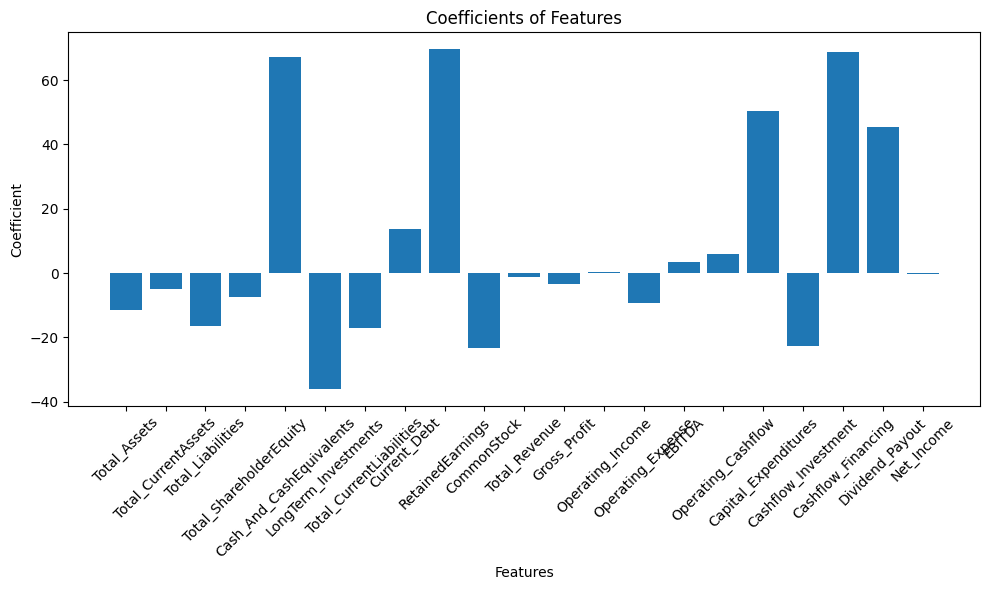

In [31]:

# Perform linear regression analysis for each symbol
for symbol in symbols_list:
    
    filtered_df = clean_df[clean_df['Ticker'] == symbol]

    # Split data into features and target variable
    X = filtered_df.drop(['Ticker','Year', 'Average_Price','Max_Price','Min_Price'], axis=1)
    y = filtered_df['Average_Price'] 
    
    # Split data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    
    # Data scaling
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    # Model training
    model = LinearRegression()
    model.fit(X_train_scaled, y_train)
    
    # Predictions on the test set
    predictions = model.predict(X_test)
    
    # Model evaluation
    train_preds = model.predict(X_train_scaled)
    test_preds = model.predict(X_test_scaled)


    
    train_rmse = np.sqrt(mean_squared_error(y_train, train_preds))
    test_rmse = np.sqrt(mean_squared_error(y_test, test_preds))

    print(f"symbol:{symbol}")
    print(f"Training predictions: {train_preds}")
    print(f"Testing Prediction: {test_rmse}")
    print(f"Training RMSE: {train_rmse}")
    print(f"Testing RMSE: {test_rmse}")
    print('R-squared:', r2_score(y_test, test_preds))
       
       
    # Get coefficients
    coefficients = model.coef_
    intercept = model.intercept_

    print("Intercept:", intercept)
    print("Coefficients:", coefficients)

    # Plot coefficients
    plt.figure(figsize=(10, 6))
    plt.bar(X.columns, coefficients)
    plt.xticks(rotation=45)
    plt.xlabel('Features')
    plt.ylabel('Coefficient')
    plt.title('Coefficients of Features')
    plt.tight_layout()
    plt.show()

 

 #save data into list if R square over 0.5 
    
    



In [32]:
# from statsmodels.tsa.arima.model import ARIMA
# filtered_df = clean_df[clean_df['Ticker'] == 'JPM']
# filtered_df
# filtered_df['Year'] = pd.to_datetime(filtered_df['Year'])

#     # Set the 'Date' column as the index
# filtered_df.set_index('Year', inplace=True)

    
#     # Split data into training and testing sets
# train_size = int(len(symbol_df) * 0.8)
# train_data = symbol_df.iloc[:train_size]
# test_data = symbol_df.iloc[train_size:]

#     # Fit ARIMA model
#     # Example: ARIMA(p=5, d=1, q=0)
# model_arima = ARIMA(train_data['Average_Price'], order=(5,1,0))
# model_fit = model_arima.fit()

#     # Make predictions
# predictions_arima = model_fit.predict(start=test_data.index[0], end=test_data.index[-1], typ='levels')

#     # Evaluate the model
# print(f"symbol:{symbol}")
# mae = abs(predictions_arima - test_data['Average_Price']).mean()
# print('Mean Absolute Error (ARIMA):', mae)

In [33]:

# from statsmodels.tsa.arima.model import ARIMA
# import pandas as pd

# for symbol in symbols_list:
    
#     filtered_df = clean_df[clean_df['Ticker'] == symbol]

#     # Convert 'Year' column to datetime format
#     filtered_df['Year'] = pd.to_datetime(filtered_df['Year'])

#     # Set the 'Year' column as the index
#     filtered_df.set_index('Year', inplace=True)

#     # Split data into training and testing sets
#     train_size = int(len(filtered_df) * 0.8)
#     train_data = filtered_df.iloc[:train_size]
#     test_data = filtered_df.iloc[train_size:]

#     # Fit ARIMA model
#     # Example: ARIMA(p=5, d=1, q=0)
#     model_arima = ARIMA(train_data['Average_Price'], order=(5,1,0))
#     model_fit = model_arima.fit()

#     # Make predictions
#     # Ensure that the start and end indices for predictions match the index of the test data
#     start_index = test_data.index[0]
#     end_index = test_data.index[-1]
#     predictions_arima = model_fit.predict(start=start_index, end=end_index, typ='levels')

#     # Evaluate the model
#     print(f"Symbol: {symbol}")
#     mae = abs(predictions_arima - test_data['Average_Price']).mean()
#     print('Mean Absolute Error (ARIMA):', mae)


In [34]:
pip install pydot-ng

Note: you may need to restart the kernel to use updated packages.


In [35]:
pip install pydot

Note: you may need to restart the kernel to use updated packages.


In [36]:
pip install graphviz

Note: you may need to restart the kernel to use updated packages.
